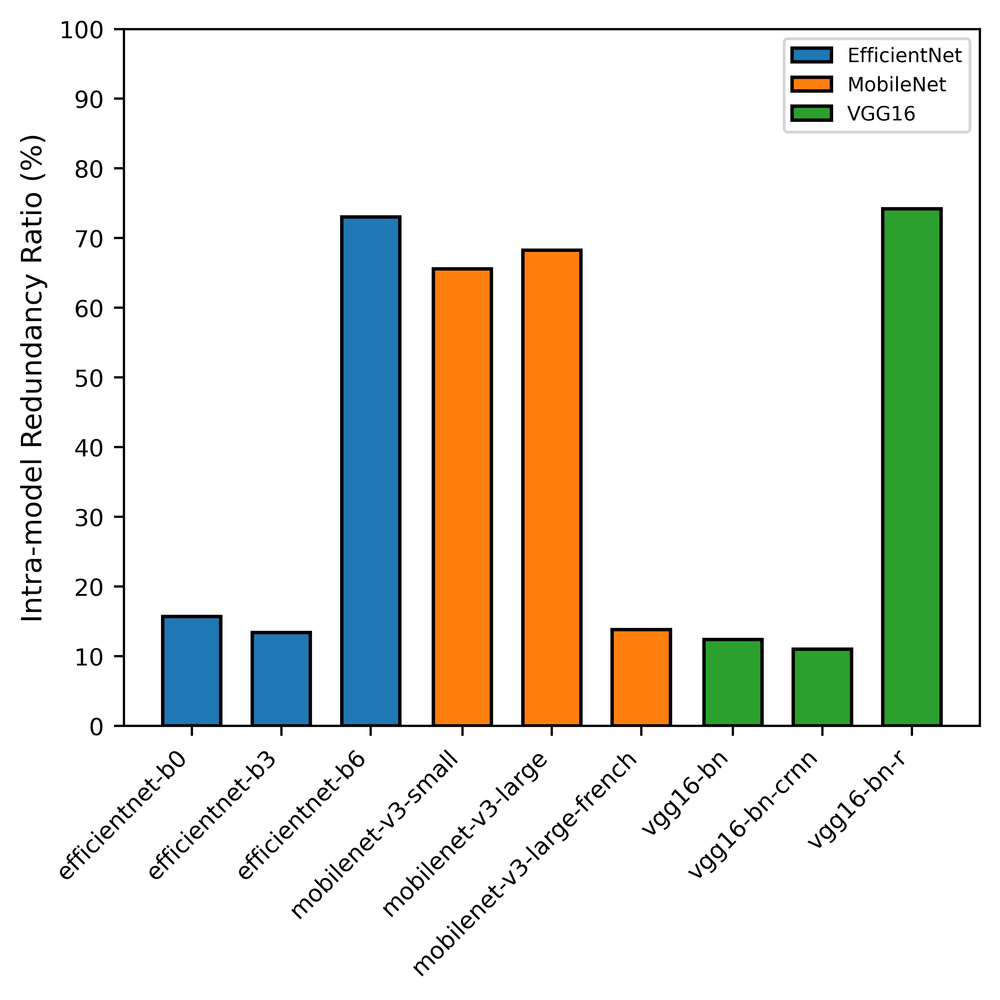

In [72]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 数据提取
data = {
    "Model": [
        "efficientnet-b0", "efficientnet-b3", "efficientnet-b6",
        "mobilenet-v3-small", "mobilenet-v3-large", "mobilenet-v3-large-french",
        "vgg16-bn", "vgg16-bn-crnn", "vgg16-bn-r"
    ],
    "Accuracy": [
        15.69, 13.41, 73.02,
        65.57, 68.27, 13.80,
        12.37, 11.01, 74.19
    ]
}

# 创建 DataFrame
df = pd.DataFrame(data)

# 创建分组
groups = {
    'EfficientNet': df[df['Model'].str.contains('efficientnet')],
    'MobileNet': df[df['Model'].str.contains('mobilenet')],
    'VGG16': df[df['Model'].str.contains('vgg16')]
}

# 设置图形，增加 DPI 来提高清晰度
fig, ax = plt.subplots(figsize=(5, 5), dpi=700)  # 调整图形大小为正方形，设置 DPI 为 150

bar_width = 0.65
spacing = 0.025  # 减少分组之间的间隔为原来的一半
offset = 0

# 定义分组位置
positions = []

for group_name, group_data in groups.items():
    pos = np.arange(len(group_data)) + offset
    positions.extend(pos)
    ax.bar(pos, group_data['Accuracy'], bar_width, label=group_name, edgecolor='black', linewidth=1.2)
    offset += len(group_data) + spacing

# 设置标签和标题
ax.set_ylabel('Intra-model Redundancy Ratio (%)')

# 减少横坐标和纵坐标刻度之间的距离
plt.xticks(ticks=positions, labels=df['Model'], rotation=45, ha='right', fontsize='small')
plt.yticks(np.arange(0, 101, 10), fontsize='small')  # 这里设置纵坐标的间隔更密集

# 调整图例位置和大小
ax.legend(loc='upper right', fontsize='x-small')  # 图例字体设置为更小

# 调整布局以适应所有标签和标题
plt.tight_layout()

# 保存图形为 PDF 格式
plt.savefig("intra.pdf", format='pdf')

# 显示图形
plt.show()

/tmp/ipykernel_2452565/3723295328.py:23: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend().set_visible(False)


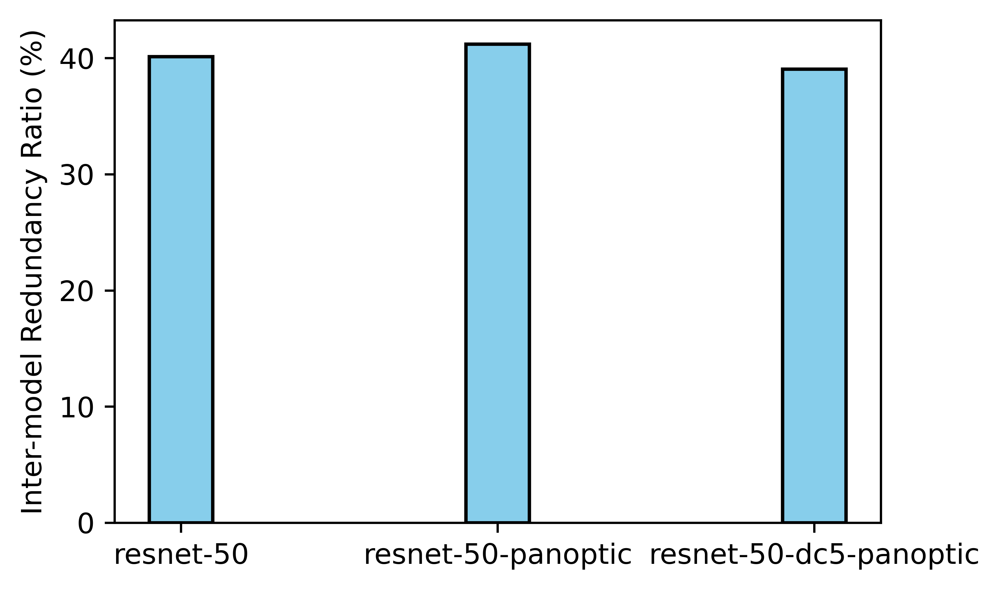

In [71]:
import matplotlib.pyplot as plt
import numpy as np

# 数据
models = [
    "ResNet50","ResNet50-dc5", "ResNet50-panoptic", "ResNet50-dc5-panoptic"
]
accuracy = [17.50, 42.69, 40.28, 40.11]

# 设置图形
fig, ax = plt.subplots(figsize=(5, 3),dpi=700)  # 调整图形大小为 5x3

# 绘制条形图
bar_width = 0.2 # 设置条形图宽度为原来的四分之一
bars = ax.bar(models, accuracy, width=bar_width, align='center', color='skyblue', edgecolor='black', linewidth=1.2)

# 设置标签和标题

ax.set_ylabel('Inter-model Redundancy Ratio (%)', fontsize=10)


# 去除图例
ax.legend().set_visible(False)

# 调整布局
plt.tight_layout()

# 保存图形为 PDF 格式
plt.savefig("inter.pdf", format='pdf')

# 显示图形
plt.show()

/tmp/ipykernel_2452565/2206640690.py:62: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax2.legend().set_visible(False)


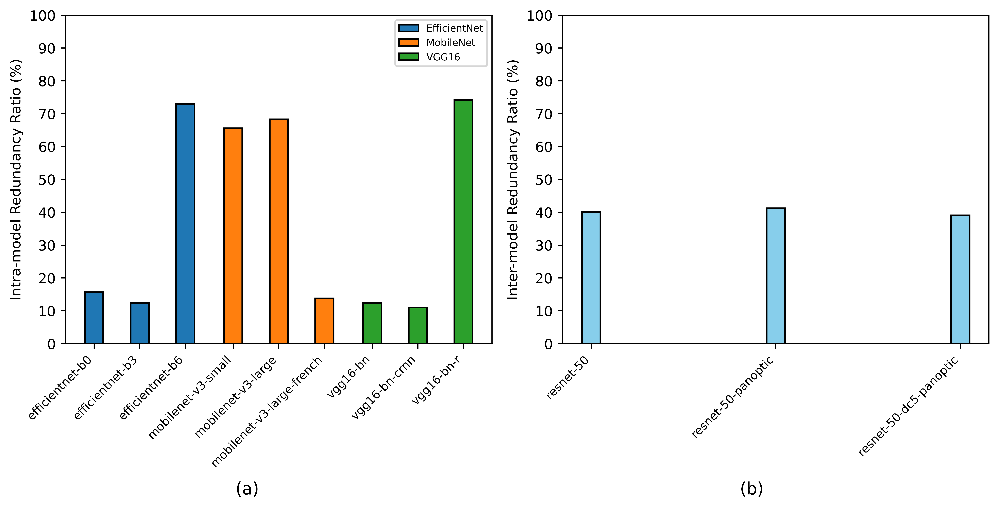

In [41]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 数据提取
data = {
    "Model": [
        "efficientnet-b0", "efficientnet-b3", "efficientnet-b6",
        "mobilenet-v3-small", "mobilenet-v3-large", "mobilenet-v3-large-french",
        "vgg16-bn", "vgg16-bn-crnn", "vgg16-bn-r"
    ],
    "Accuracy": [
        15.69, 12.41, 73.02,
        65.57, 68.27, 13.80,
        12.37, 11.01, 74.19
    ]
}

# 创建 DataFrame
df = pd.DataFrame(data)

# 创建分组
groups = {
    'EfficientNet': df[df['Model'].str.contains('efficientnet')],
    'MobileNet': df[df['Model'].str.contains('mobilenet')],
    'VGG16': df[df['Model'].str.contains('vgg16')]
}

# 创建图形和子图
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5), dpi=700)

# 绘制第一个图
bar_width = 0.4  # 合适的宽度以便于视觉效果统一
spacing = 0.05  # 分组之间的间隔
offset = 0

# 定义分组位置
positions = []

for group_name, group_data in groups.items():
    pos = np.arange(len(group_data)) + offset
    positions.extend(pos)
    ax1.bar(pos, group_data['Accuracy'], bar_width, label=group_name, edgecolor='black', linewidth=1.2)
    offset += len(group_data) + spacing

ax1.set_ylabel('Intra-model Redundancy Ratio (%)')
ax1.set_xticks(positions)
ax1.set_xticklabels(df['Model'], rotation=45, ha='right', fontsize='small')
ax1.set_yticks(np.arange(0, 101, 10))
ax1.legend(loc='upper right', fontsize='x-small')

# 绘制第二个图
models = ["resnet-50", "resnet-50-panoptic", "resnet-50-dc5-panoptic"]
accuracy = [40.13, 41.20, 39.05]
bar_width = 0.1  # 合适的宽度以便于视觉效果统一

bars = ax2.bar(models, accuracy, width=bar_width, align='center', color='skyblue', edgecolor='black', linewidth=1.2)
ax2.set_ylabel('Inter-model Redundancy Ratio (%)')
ax2.set_xticks(np.arange(len(models)))
ax2.set_xticklabels(models, rotation=45, ha='right', fontsize='small')
ax2.set_yticks(np.arange(0, 101, 10))
ax2.legend().set_visible(False)

# 在每个图下方显示 (a) 和 (b)
fig.text(0.25, 0.01, '(a)', ha='center', fontsize=12)
fig.text(0.75, 0.01, '(b)', ha='center', fontsize=12)

# 调整布局
plt.tight_layout(rect=[0, 0.03, 1, 1])

# 保存图形为 PDF 格式
plt.savefig("ratio.pdf", format='pdf')

# 显示图形
plt.show()

/tmp/ipykernel_2452565/856166353.py:65: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax2.legend().set_visible(False)


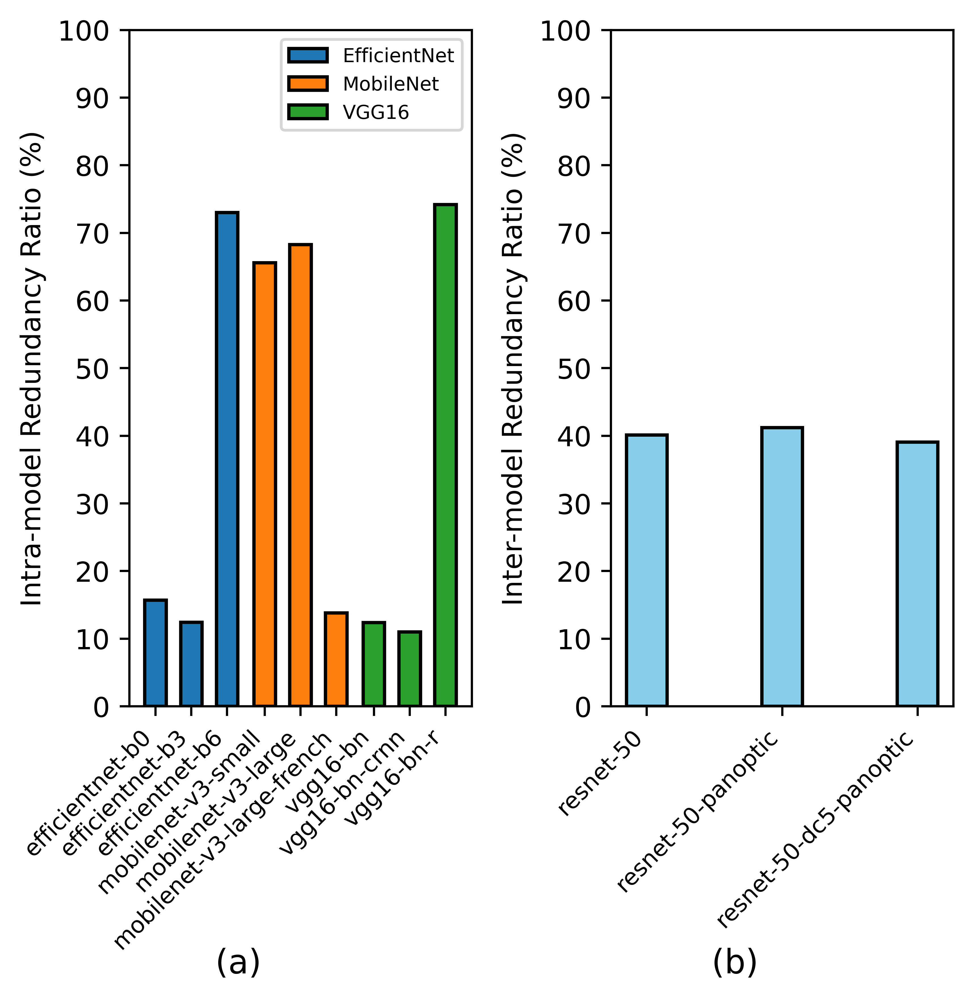

In [54]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 数据提取
data = {
    "Model": [
        "efficientnet-b0", "efficientnet-b3", "efficientnet-b6",
        "mobilenet-v3-small", "mobilenet-v3-large", "mobilenet-v3-large-french",
        "vgg16-bn", "vgg16-bn-crnn", "vgg16-bn-r"
    ],
    "Accuracy": [
        15.69, 12.41, 73.02,
        65.57, 68.27, 13.80,
        12.37, 11.01, 74.19
    ]
}

# 创建 DataFrame
df = pd.DataFrame(data)

# 创建分组
groups = {
    'EfficientNet': df[df['Model'].str.contains('efficientnet')],
    'MobileNet': df[df['Model'].str.contains('mobilenet')],
    'VGG16': df[df['Model'].str.contains('vgg16')]
}

# 创建图形和子图
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(5, 5), dpi=700)

# 绘制第一个图
bar_width = 0.6  # 合适的宽度以便于视觉效果统一
spacing = 0.05  # 分组之间的间隔
offset = 0

# 定义分组位置
positions = []

for group_name, group_data in groups.items():
    pos = np.arange(len(group_data)) + offset
    positions.extend(pos)
    ax1.bar(pos, group_data['Accuracy'], bar_width, label=group_name, edgecolor='black', linewidth=1.2)
    offset += len(group_data) + spacing

ax1.set_ylabel('Intra-model Redundancy Ratio (%)')
ax1.set_xticks(positions)
ax1.set_xticklabels(df['Model'], rotation=45, ha='right', fontsize='small')
ax1.set_yticks(np.arange(0, 101, 10))
ax1.legend(loc='upper right', fontsize='x-small')

# 在每个图下方显示 (a)
fig.text(0.25, 0.01, '(a)', ha='center', fontsize=12)

# 绘制第二个图
models = ["resnet-50", "resnet-50-panoptic", "resnet-50-dc5-panoptic"]
accuracy = [40.13, 41.20, 39.05]
bar_width = 0.3  # 合适的宽度以便于视觉效果统一

ax2.bar(models, accuracy, width=bar_width, align='center', color='skyblue', edgecolor='black', linewidth=1.2)
ax2.set_ylabel('Inter-model Redundancy Ratio (%)')
ax2.set_xticks(np.arange(len(models)))
ax2.set_xticklabels(models, rotation=45, ha='right', fontsize='small')
ax2.set_yticks(np.arange(0, 101, 10))
ax2.legend().set_visible(False)

# 在第二个图下方显示 (b)
fig.text(0.75, 0.01, '(b)', ha='center', fontsize=12)

# 调整布局
plt.tight_layout()

# 保存图形为 PDF 格式
plt.savefig("rates.pdf", format='pdf')

# 显示图形
plt.show()

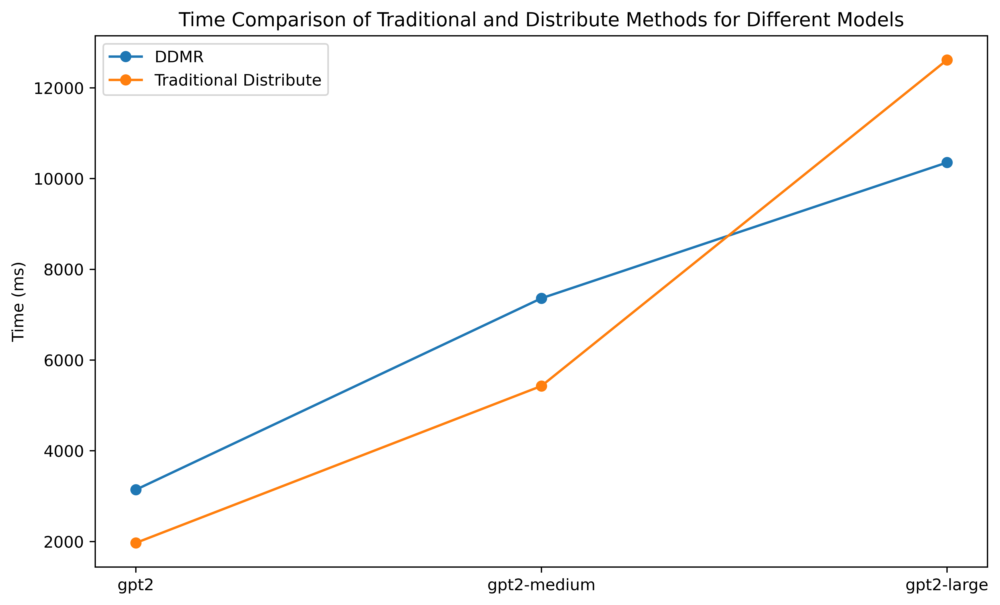

In [7]:
import matplotlib.pyplot as plt

# 数据
models = ['gpt2', 'gpt2-medium', 'gpt2-large']
traditional_times = [3142, 7362, 10354]
distribute_times = [1970, 5429, 12615]

# 绘图
plt.figure(figsize=(10, 6),dpi=700)
plt.plot(models, traditional_times, marker='o', label='DDMR')
plt.plot(models, distribute_times, marker='o', label='Traditional Distribute')

# 添加标题和标签
plt.title('Time Comparison of Traditional and Distribute Methods for Different Models')
plt.ylabel('Time (ms)')
plt.legend()
plt.grid(False)

# 保存为 PDF
# plt.savefig('time_comparison.pdf')
plt.show()
plt.close()

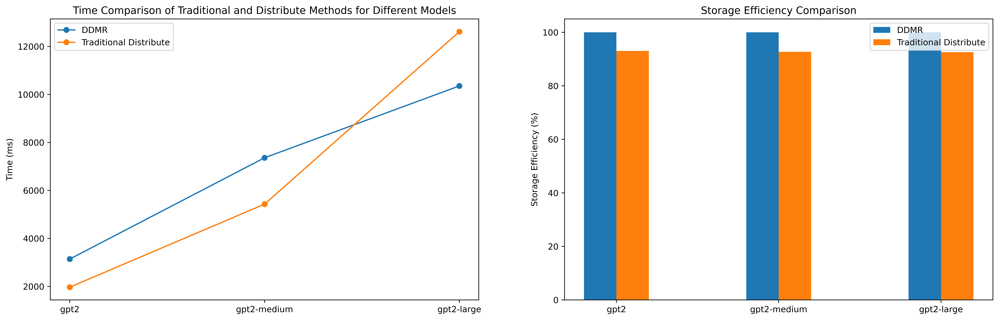

In [9]:
import matplotlib.pyplot as plt

# 数据
models = ['gpt2', 'gpt2-medium', 'gpt2-large']
traditional_times = [3142, 7362, 10354]
distribute_times = [1970, 5429, 12615]
ddmr_efficiency = [100, 100, 100]
traditional_efficiency = [93.04, 92.72, 92.58]

# 绘图
fig, axs = plt.subplots(1, 2, figsize=(20, 6), dpi=700)

# 第一个图表
axs[0].plot(models, traditional_times, marker='o', label='DDMR')
axs[0].plot(models, distribute_times, marker='o', label='Traditional Distribute')
axs[0].set_title('Time Comparison of Traditional and Distribute Methods for Different Models')
axs[0].set_ylabel('Time (ms)')
axs[0].legend()
axs[0].grid(False)

# 第二个图表（条形统计图）
bar_width = 0.2
index = range(len(models))

axs[1].bar(index, ddmr_efficiency, bar_width, label='DDMR')
axs[1].bar([i + bar_width for i in index], traditional_efficiency, bar_width, label='Traditional Distribute')
axs[1].set_title('Storage Efficiency Comparison')
axs[1].set_ylabel('Storage Efficiency (%)')
axs[1].set_xticks([i + bar_width / 2 for i in index])
axs[1].set_xticklabels(models)
axs[1].legend()

# 保存为 PDF
plt.savefig('time_and_efficiency_comparison.pdf')
plt.show()
plt.close()

In [16]:
import matplotlib.pyplot as plt

# 数据
models = ['gpt2', 'gpt2-medium', 'gpt2-large']
# 推送时间数据
push_traditional_times = [3142, 7362, 10354]
push_distribute_times = [1970, 5429, 12615]
# 拉取时间数据
pull_traditional_times = [778, 1912, 2347]
pull_distribute_times = [672, 1706, 3661]
# 存储效率数据
ddmr_efficiency = [100, 100, 100]
traditional_efficiency = [93.04, 92.72, 92.58]

# 绘图
fig, axs = plt.subplots(1, 3, figsize=(30, 6), dpi=700)

# 第一个图表：推送时间
axs[0].plot(models, push_traditional_times, marker='o', label='DDMR')
axs[0].plot(models, push_distribute_times, marker='o', label='Traditional Distribute')
axs[0].set_title('Push Time Comparison')
axs[0].set_ylabel('Time (ms)')
axs[0].legend()
axs[0].grid(False)

# 第二个图表：拉取时间
axs[1].plot(models, pull_traditional_times, marker='o', label='DDMR')
axs[1].plot(models, pull_distribute_times, marker='o', label='Traditional Distribute')
axs[1].set_title('Pull Time Comparison')
axs[1].set_ylabel('Time (ms)')
axs[1].legend()
axs[1].grid(False)

# 第三个图表：存储效率（条形统计图）
bar_width = 0.2
index = range(len(models))

axs[2].bar(index, ddmr_efficiency, bar_width, label='DDMR')
axs[2].bar([i + bar_width for i in index], traditional_efficiency, bar_width, label='Traditional Distribute')
axs[2].set_title('Storage Efficiency Comparison')
axs[2].set_ylabel('Storage Efficiency (%)')
axs[2].set_xticks([i + bar_width / 2 for i in index])
axs[2].set_xticklabels(models)
axs[2].legend()

# 保存为 PDF
# plt.savefig('time_and_efficiency_comparison.pdf')
plt.show()
plt.close()

In [25]:
import matplotlib.pyplot as plt

# 数据
models = ['gpt2', 'gpt2-medium', 'gpt2-large', 'resnet50', 'resnet50-dc5', 'resnet50-panoptic', 'resnet50-dc5-panoptic']
# 推送时间数据
push_traditional_times = [3142, 7362, 10354, 687, 511, 583, 543]
push_distribute_times = [1970, 5429, 12615, 393, 607, 621, 609]
# 拉取时间数据
pull_traditional_times = [778, 1912, 2347, 579, 964, 1005, 1028]
pull_distribute_times = [672, 1706, 3661, 1085, 1694, 1761, 1769]
# 存储效率数据
ddmr_efficiency = [100, 100, 100, 100, 100, 100, 100]
traditional_efficiency = [93.04, 92.72, 92.58, 82.5, 57.30, 59.71, 59.89]

# 绘图
fig, axs = plt.subplots(1, 3, figsize=(30, 6), dpi=700)

# 第一个图表：推送时间
axs[0].plot(models, push_traditional_times, marker='o', label='DDMR')
axs[0].plot(models, push_distribute_times, marker='o', label='Traditional Distribute')
axs[0].set_title('Push Time Comparison')
axs[0].set_ylabel('Time (ms)')
axs[0].legend()
axs[0].grid(False)
axs[0].tick_params(axis='x', rotation=45)

# 第二个图表：拉取时间
axs[1].plot(models, pull_traditional_times, marker='o', label='DDMR')
axs[1].plot(models, pull_distribute_times, marker='o', label='Traditional Distribute')
axs[1].set_title('Pull Time Comparison')
axs[1].set_ylabel('Time (ms)')
axs[1].legend()
axs[1].grid(False)
axs[1].tick_params(axis='x', rotation=45)

# 第三个图表：存储效率（条形统计图）
bar_width = 0.35
index = range(len(models))

axs[2].bar(index, ddmr_efficiency, bar_width, label='DDMR')
axs[2].bar([i + bar_width for i in index], traditional_efficiency, bar_width, label='Traditional Distribute')
axs[2].set_title('Storage Efficiency Comparison')
axs[2].set_ylabel('Storage Efficiency (%)')
axs[2].set_xticks([i + bar_width / 2 for i in index])
axs[2].set_xticklabels(models)
axs[2].legend()
axs[2].tick_params(axis='x', rotation=45)

# 调整布局以防止标签被截断
plt.tight_layout()

# 保存为 PDF，去除多余的白边
plt.savefig('time_and_efficiency_comparison.pdf', bbox_inches='tight')
plt.show()
plt.close()

In [31]:
import matplotlib.pyplot as plt

# 数据
models = ['gpt2', 'gpt2-medium', 'gpt2-large', 'resnet50', 'resnet50-dc5', 'resnet50-panoptic', 'resnet50-dc5-panoptic']
# 推送时间数据
push_traditional_times = [3142, 7362, 10354, 687, 511, 583, 543]
push_distribute_times = [1970, 5429, 12615, 393, 607, 621, 609]
# 拉取时间数据
pull_traditional_times = [778, 1912, 2347, 579, 964, 1005, 1028]
pull_distribute_times = [672, 1706, 3661, 1085, 1694, 1761, 1769]
# 存储效率数据
ddmr_efficiency = [100, 100, 100, 100, 100, 100, 100]
traditional_efficiency = [93.04, 92.72, 92.58, 82.5, 57.30, 59.71, 59.89]

# 设置字体大小
font = {'size': 25}

plt.rc('font', **font)

# 绘图
fig, axs = plt.subplots(1, 3, figsize=(30, 10), dpi=700)  # 将高度调整为 10

# 第一个图表：推送时间
axs[0].plot(models, push_traditional_times, marker='o', label='DDMR')
axs[0].plot(models, push_distribute_times, marker='o', label='Traditional Distribute')
axs[0].set_title('Push Time Comparison')
axs[0].set_ylabel('Time (ms)')
axs[0].legend(fontsize=20)
axs[0].grid(False)
axs[0].tick_params(axis='x', rotation=45)
axs[0].set_xticks(range(len(models)))
axs[0].set_xticklabels(models)
# 第二个图表：拉取时间
axs[1].plot(models, pull_traditional_times, marker='o', label='DDMR')
axs[1].plot(models, pull_distribute_times, marker='o', label='Traditional Distribute')
axs[1].set_title('Pull Time Comparison')
axs[1].set_ylabel('Time (ms)')
axs[1].legend(fontsize=20)
axs[1].grid(False)
axs[1].tick_params(axis='x', rotation=45)
axs[1].set_xticks(range(len(models)))
axs[1].set_xticklabels(models)
# 第三个图表：存储效率（条形统计图）
bar_width = 0.35
index = range(len(models))

axs[2].bar(index, ddmr_efficiency, bar_width, label='DDMR')
axs[2].bar([i + bar_width for i in index], traditional_efficiency, bar_width, label='Traditional Distribute')
axs[2].set_title('Storage Efficiency Comparison')
axs[2].set_ylabel('Storage Efficiency (%)')
axs[2].set_xticks([i + bar_width / 2 for i in index])
axs[2].set_xticklabels(models)
axs[2].legend(fontsize=20)
axs[2].tick_params(axis='x', rotation=45)

# 调整布局以防止标签被截断
plt.tight_layout()

# 保存为 PDF，去除多余的白边
plt.savefig('time_and_efficiency_comparison.pdf', bbox_inches='tight')
plt.show()
plt.close()

In [37]:
import matplotlib.pyplot as plt
import numpy as np

# 数据
models = ['GPT2', 'GPT2-medium', 'GPT2-large', 'ResNet50', 'ResNet50-dc5', 'ResNet50-panoptic', 'ResNet50-dc5-panoptic']
# 推送时间数据
push_traditional_times = [3142, 7362, 10354, 687, 511, 583, 543]
push_distribute_times = [1970, 5429, 12615, 393, 607, 621, 609]
# 拉取时间数据
pull_traditional_times = [778, 1912, 2347, 579, 964, 1005, 1028]
pull_distribute_times = [672, 1706, 3661, 1085, 1694, 1761, 1769]
# 存储效率数据
ddmr_efficiency = [100, 100, 100, 100, 100, 100, 100]
traditional_efficiency = [93.04, 92.72, 92.58, 82.5, 57.30, 59.71, 59.89]

# 设置字体大小
font = {'size': 25}

plt.rc('font', **font)

# 绘图
fig, axs = plt.subplots(1, 3, figsize=(30, 10), dpi=700)  # 将高度调整为 10

# 设置x轴标签的位置
x = np.arange(len(models))

# 第一个图表：推送时间
axs[0].plot(x, push_traditional_times, marker='o', label='DDMR')
axs[0].plot(x, push_distribute_times, marker='o', label='Traditional Distribute')
axs[0].set_title('Push Time Comparison')
axs[0].set_ylabel('Time (ms)')
axs[0].legend(fontsize=20)
axs[0].grid(False)
axs[0].set_xticks(x)
axs[0].set_xticklabels(models, rotation=45, ha='right')

# 第二个图表：拉取时间
axs[1].plot(x, pull_traditional_times, marker='o', label='DDMR')
axs[1].plot(x, pull_distribute_times, marker='o', label='Traditional Distribute')
axs[1].set_title('Pull Time Comparison')
axs[1].set_ylabel('Time (ms)')
axs[1].legend(fontsize=20)
axs[1].grid(False)
axs[1].set_xticks(x)
axs[1].set_xticklabels(models, rotation=45, ha='right')

# 第三个图表：存储效率（条形统计图）
bar_width = 0.35

axs[2].bar(x - bar_width / 2, ddmr_efficiency, bar_width, label='DDMR')
axs[2].bar(x + bar_width / 2, traditional_efficiency, bar_width, label='Traditional Distribute')
axs[2].set_title('Storage Efficiency Comparison')
axs[2].set_ylabel('Storage Efficiency (%)')
axs[2].set_xticks(x)
axs[2].set_xticklabels(models, rotation=45, ha='right')
axs[2].legend(fontsize=20)

# 调整布局以防止标签被截断
plt.tight_layout()

# 保存为 PDF，去除多余的白边
plt.savefig('time_and_efficiency_comparison.pdf', bbox_inches='tight')
plt.show()
plt.close()

In [61]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 数据提取
data = {
    "Model": [
        "EfficientNet-b0", "EfficientNet-b3", "EfficientNet-b6",
        "MobileNet-v3-small", "MobileNet-v3-large", "MobileNet-v3-large-french",
        "VGG16-bn", "VGG16-bn-crnn", "VGG16-bn-r"
    ],
    "Accuracy": [
        15.69, 13.41, 73.02,
        65.57, 68.27, 13.80,
        12.37, 11.01, 74.19
    ]
}

# 创建 DataFrame
df = pd.DataFrame(data)

# 创建分组
groups = {
    'EfficientNet': df[df['Model'].str.contains('EfficientNet')],
    'MobileNet': df[df['Model'].str.contains('MobileNet')],
    'VGG16': df[df['Model'].str.contains('VGG16')]
}

# 设置图形，增加 DPI 来提高清晰度
fig, axs = plt.subplots(2, 1, figsize=(10, 20), dpi=700)  # 调整图形大小，并设置 DPI

# 设置字体大小
font = {'size': 20}
plt.rc('font', **font)

# 第一个子图
ax = axs[0]
bar_width = 0.65
spacing = 0.025  # 分组之间的间隔
offset = 0

# 定义分组位置
positions = []

for group_name, group_data in groups.items():
    pos = np.arange(len(group_data)) + offset
    positions.extend(pos)
    ax.bar(pos, group_data['Accuracy'], bar_width, label=group_name, edgecolor='black', linewidth=1.2)
    offset += len(group_data) + spacing

# 设置标签和标题
ax.set_ylabel('Intra-model Redundancy Ratio (%)')
ax.set_title('Intra-model Redundancy Ratio')

# 设置横坐标和纵坐标刻度
ax.set_xticks(positions)
ax.set_xticklabels(df['Model'], rotation=45, ha='right')
ax.set_yticks(np.arange(0, 101, 10))

# 调整图例位置和大小
ax.legend(loc='upper right', fontsize=15)


# 第二个子图
ax = axs[1]
# 数据
models = [
    "ResNet50", "ResNet50-dc5", "ResNet50-panoptic", "ResNet50-dc5-panoptic"
]
accuracy = [17.50, 42.69, 40.28, 40.11]

# 绘制条形图
bar_width = 0.25  # 调整条形图宽度
positions = np.arange(len(models))

bars = ax.bar(positions, accuracy, width=bar_width, align='center', color='skyblue', edgecolor='black', linewidth=1.2)

# 设置标签和标题
ax.set_ylabel('Inter-model Redundancy Ratio (%)')
ax.set_title('Inter-model Redundancy Ratio')

# 设置横坐标和纵坐标刻度
ax.set_xticks(positions)
ax.set_xticklabels(models, rotation=45, ha='right')
ax.set_yticks(np.arange(0, 51, 10))

# 去除图例
ax.legend().set_visible(False)


# 调整布局以适应所有标签和标题
plt.tight_layout()

# 保存图形为 PDF 格式
plt.savefig("combined_figure.pdf", format='pdf')

# 显示图形
plt.show()

/tmp/ipykernel_3486721/1425666998.py:88: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend().set_visible(False)


In [22]:
import matplotlib.pyplot as plt
import numpy as np

# 数据
models = ['GPT2', 'GPT2-medium', 'GPT2-large', 'ResNet50', 'ResNet50-dc5', 'ResNet50-panoptic', 'ResNet50-dc5-panoptic']
# 推送时间数据
push_traditional_times = [3142, 7362, 10354, 687, 511, 583, 543]
push_distribute_times = [1970, 5429, 12615, 393, 607, 621, 609]
# 拉取时间数据
pull_traditional_times = [778, 1912, 2347, 579, 964, 1005, 1028]
pull_distribute_times = [672, 1706, 3661, 1085, 1694, 1761, 1769]
# 存储效率数据
ddmr_efficiency = [100, 100, 100, 100, 100, 100, 100]
traditional_efficiency = [93.04, 92.72, 92.58, 82.5, 57.30, 59.71, 59.89]

# 设置字体大小
font = {'size': 25}

plt.rc('font', **font)

# 绘图
fig, axs = plt.subplots(1, 3, figsize=(30, 15), dpi=700)  # 调整高度为15

# 设置x轴标签的位置
x = np.arange(len(models))

# 第一个图表：推送时间
axs[0].plot(x, push_traditional_times, marker='o', label='DDMR')
axs[0].plot(x, push_distribute_times, marker='o', label='Traditional Distribute')
axs[0].set_title('Push Time Comparison')
axs[0].set_ylabel('Time (ms)')
axs[0].legend(fontsize=20)
axs[0].grid(False)
axs[0].set_xticks(x)
axs[0].set_xticklabels(models, rotation=45, ha='right')

# 第二个图表：拉取时间
axs[1].plot(x, pull_traditional_times, marker='o', label='DDMR')
axs[1].plot(x, pull_distribute_times, marker='o', label='Traditional Distribute')
axs[1].set_title('Pull Time Comparison')
axs[1].set_ylabel('Time (ms)')
axs[1].legend(fontsize=20)
axs[1].grid(False)
axs[1].set_xticks(x)
axs[1].set_xticklabels(models, rotation=45, ha='right')

# 第三个图表：存储效率（条形统计图）
bar_width = 0.35

axs[2].bar(x - bar_width / 2, ddmr_efficiency, bar_width, label='DDMR')
axs[2].bar(x + bar_width / 2, traditional_efficiency, bar_width, label='Traditional Distribute')
axs[2].set_title('Storage Efficiency Comparison')
axs[2].set_ylabel('Storage Efficiency (%)')
axs[2].set_xticks(x)
axs[2].set_xticklabels(models, rotation=45, ha='right')
axs[2].legend(fontsize=20)

# 调整布局以防止标签被截断
plt.tight_layout(pad=3.0, rect=[0, 0.2, 1, 1])  # 增加底部间距

# 在每个子图的正下方添加标签
fig.text(0.17, 0.2, '(a)', ha='center', fontsize=30)
fig.text(0.5, 0.2, '(b)', ha='center', fontsize=30)
fig.text(0.83, 0.2, '(c)', ha='center', fontsize=30)

# 保存为 PDF，去除多余的白边
plt.savefig('time_and_efficiency_comparison.pdf', bbox_inches='tight')
plt.show()
plt.close()

In [31]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# 数据提取
data = {
    "Model": [
        "EfficientNet-b0", "EfficientNet-b3", "EfficientNet-b6",
        "MobileNet-v3-small", "MobileNet-v3-large", "MobileNet-v3-large-french",
        "VGG16-bn", "VGG16-bn-crnn", "VGG16-bn-r"
    ],
    "Accuracy": [
        15.69, 13.41, 73.02,
        65.57, 68.27, 13.80,
        12.37, 11.01, 74.19
    ]
}

# 创建 DataFrame
df = pd.DataFrame(data)

# 创建分组
groups = {
    'EfficientNet': df[df['Model'].str.contains('EfficientNet')],
    'MobileNet': df[df['Model'].str.contains('MobileNet')],
    'VGG16': df[df['Model'].str.contains('VGG16')]
}

# 设置图形，增加 DPI 来提高清晰度
fig, axs = plt.subplots(2, 1, figsize=(10, 20), dpi=700)  # 调整图形大小，并设置 DPI

# 设置字体大小
font = {'size': 20}
plt.rc('font', **font)

# 第一个子图
ax = axs[0]
bar_width = 0.65
spacing = 0.025  # 分组之间的间隔
offset = 0

# 定义分组位置
positions = []

for group_name, group_data in groups.items():
    pos = np.arange(len(group_data)) + offset
    positions.extend(pos)
    ax.bar(pos, group_data['Accuracy'], bar_width, label=group_name, edgecolor='black', linewidth=1.2)
    offset += len(group_data) + spacing

# 设置标签和标题
ax.set_ylabel('Intra-model Redundancy Ratio (%)')
ax.set_title('Intra-model Redundancy Ratio')

# 设置横坐标和纵坐标刻度
ax.set_xticks(positions)
ax.set_xticklabels(df['Model'], rotation=45, ha='right')
ax.set_yticks(np.arange(0, 101, 10))

# 调整图例位置和大小
ax.legend(loc='upper right', fontsize=15)

# 第二个子图
ax = axs[1]
# 数据
models = [
    "ResNet50", "ResNet50-dc5", "ResNet50-panoptic", "ResNet50-dc5-panoptic"
]
accuracy = [17.50, 42.69, 40.28, 40.11]

# 绘制条形图
bar_width = 0.25  # 调整条形图宽度
positions = np.arange(len(models))

bars = ax.bar(positions, accuracy, width=bar_width, align='center', color='skyblue', edgecolor='black', linewidth=1.2)

# 设置标签和标题
ax.set_ylabel('Inter-model Redundancy Ratio (%)')
ax.set_title('Inter-model Redundancy Ratio')

# 设置横坐标和纵坐标刻度
ax.set_xticks(positions)
ax.set_xticklabels(models, rotation=45, ha='right')
ax.set_yticks(np.arange(0, 51, 10))

# 去除图例
ax.legend().set_visible(False)

# 调整布局以适应所有标签和标题
plt.tight_layout(pad=3.0, rect=[0, 0.1, 1, 1])  # 增加底部间距

# 在每个子图的正下方添加标签
fig.text(0.5, 0.55, '(a)', ha='center', fontsize=30)
fig.text(0.5, 0.1, '(b)', ha='center', fontsize=30)

# 保存图形为 PDF 格式
plt.savefig("combined_figure.pdf", format='pdf')

# 显示图形
plt.show()

/tmp/ipykernel_1235032/3704359358.py:87: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend().set_visible(False)


In [4]:
import matplotlib.pyplot as plt
import numpy as np

# 数据
models = ['GPT2', 'GPT2-medium', 'GPT2-large', 'ResNet50', 'ResNet50-dc5', 'ResNet50-panoptic', 'ResNet50-dc5-panoptic']
# 推送时间数据
push_traditional_times = [3142, 7362, 10354, 687, 511, 583, 543]
push_distribute_times = [1970, 5429, 12615, 393, 607, 621, 609]
# 拉取时间数据
pull_traditional_times = [778, 1912, 2347, 579, 964, 1005, 1028]
pull_distribute_times = [672, 1706, 3661, 1085, 1694, 1761, 1769]
# 存储效率数据
ddmr_efficiency = [100, 100, 100, 100, 100, 100, 100]
traditional_efficiency = [93.04, 92.72, 92.58, 82.5, 57.30, 59.71, 59.89]

# 设置字体大小
font = {'size': 25}

plt.rc('font', **font)

# 绘图
fig, axs = plt.subplots(1, 3, figsize=(30, 15), dpi=700)  # 调整高度为15

# 设置x轴标签的位置
x = np.arange(len(models))

# 第一个图表：推送时间
axs[0].plot(x, push_traditional_times, marker='^', markersize=10, linestyle='-', linewidth=3, label='$Re^{2}po$ Framework')
axs[0].plot(x, push_distribute_times, marker='s', markersize=10, linestyle='-', linewidth=3, label='Traditional Distributed\nStorage')
axs[0].set_title('Push Time Comparison')
axs[0].set_ylabel('Time (ms)')
axs[0].legend(fontsize=20)
axs[0].grid(False)
axs[0].set_xticks(x)
axs[0].set_xticklabels(models, rotation=45, ha='right')

# 第二个图表：拉取时间
axs[1].plot(x, pull_traditional_times, marker='^', markersize=10, linestyle='-', linewidth=3, label='$Re^{2}po$ Framework')
axs[1].plot(x, pull_distribute_times, marker='s', markersize=10, linestyle='-', linewidth=3, label='Traditional Distributed\nStorage')
axs[1].set_title('Pull Time Comparison')
axs[1].set_ylabel('Time (ms)')
axs[1].legend(fontsize=20)
axs[1].grid(False)
axs[1].set_xticks(x)
axs[1].set_xticklabels(models, rotation=45, ha='right')

# 第三个图表：存储效率（条形统计图）
bar_width = 0.35

axs[2].bar(x - bar_width / 2, ddmr_efficiency, bar_width, label='DDMR')
axs[2].bar(x + bar_width / 2, traditional_efficiency, bar_width, label='Traditional Distributed\nStorage')
axs[2].set_title('Storage Efficiency Comparison')
axs[2].set_ylabel('Storage Efficiency (%)')
axs[2].set_xticks(x)
axs[2].set_xticklabels(models, rotation=45, ha='right')
axs[2].legend(fontsize=20)

# 调整布局以防止标签被截断
plt.tight_layout(pad=3.0, rect=[0, 0.2, 1, 1])  # 增加底部间距

# 在每个子图的正下方添加标签
fig.text(0.17, 0.2, '(a)', ha='center', fontsize=30)
fig.text(0.5, 0.2, '(b)', ha='center', fontsize=30)
fig.text(0.83, 0.2, '(c)', ha='center', fontsize=30)

# 保存为 PDF，去除多余的白边
plt.savefig('time_and_efficiency_comparison.pdf', bbox_inches='tight')
plt.show()
plt.close()

In [2]:
import matplotlib.pyplot as plt
import numpy as np

# 数据
models = ['GPT2', 'GPT2-medium', 'GPT2-large', 'ResNet50', 'ResNet50-dc5', 'ResNet50-panoptic', 'ResNet50-dc5-panoptic']
# 推送时间数据
push_traditional_times = [3142, 7362, 10354, 687, 511, 583, 543]
push_distribute_times = [1970, 5429, 12615, 393, 607, 621, 609]
# 拉取时间数据
pull_traditional_times = [778, 1912, 2347, 579, 964, 1005, 1028]
pull_distribute_times = [672, 1706, 3661, 1085, 1694, 1761, 1769]
# 存储效率数据
ddmr_efficiency = [100, 100, 100, 100, 100, 100, 100]
traditional_efficiency = [93.04, 92.72, 92.58, 82.5, 57.30, 59.71, 59.89]

# 设置字体大小
font = {'size': 25}
plt.rc('font', **font)

# 绘图
fig, axs = plt.subplots(3, 1, figsize=(30, 45), dpi=700)  # 调整高度为45，垂直排列三个子图

# 设置x轴标签的位置
x = np.arange(len(models))

# 第一个图表：推送时间
axs[0].plot(x, push_traditional_times, marker='^', markersize=10, linestyle='-', linewidth=3, label='DDMR')
axs[0].plot(x, push_distribute_times, marker='s', markersize=10, linestyle='-', linewidth=3, label='Traditional Distribute')
axs[0].set_title('Push Time Comparison')
axs[0].set_ylabel('Time (ms)')
axs[0].legend(fontsize=20)
axs[0].grid(False)
axs[0].set_xticks(x)
axs[0].set_xticklabels(models, rotation=0, ha='center')  # 设置x标签为水平

# 第二个图表：拉取时间
axs[1].plot(x, pull_traditional_times, marker='^', markersize=10, linestyle='-', linewidth=3, label='DDMR')
axs[1].plot(x, pull_distribute_times, marker='s', markersize=10, linestyle='-', linewidth=3, label='Traditional Distribute')
axs[1].set_title('Pull Time Comparison')
axs[1].set_ylabel('Time (ms)')
axs[1].legend(fontsize=20)
axs[1].grid(False)
axs[1].set_xticks(x)
axs[1].set_xticklabels(models, rotation=0, ha='center')  # 设置x标签为水平

# 第三个图表：存储效率（条形统计图）
bar_width = 0.35

axs[2].bar(x - bar_width / 2, ddmr_efficiency, bar_width, label='DDMR')
axs[2].bar(x + bar_width / 2, traditional_efficiency, bar_width, label='Traditional Distribute')
axs[2].set_title('Storage Efficiency Comparison')
axs[2].set_ylabel('Storage Efficiency (%)')
axs[2].set_xticks(x)
axs[2].set_xticklabels(models, rotation=0, ha='center')  # 设置x标签为水平
axs[2].legend(fontsize=20)

# 调整布局以防止标签被截断
plt.tight_layout(pad=3.0, rect=[0, 0, 1, 1])  # 增加底部间距

# 在每个子图的左下方添加标签
fig.text(0.07, 0.95, '(a)', ha='center', fontsize=30)
fig.text(0.07, 0.65, '(b)', ha='center', fontsize=30)
fig.text(0.07, 0.35, '(c)', ha='center', fontsize=30)

# 保存为 PDF，去除多余的白边
plt.savefig('test.pdf', bbox_inches='tight')
plt.show()
plt.close()